# Mask R-CNN Swin-S

In [1]:
# Check Pytorch installation
import torch, torchvision
print(f"PyTorch version={torch.__version__}, {torch.cuda.is_available()=}")

# Check MMDetection installation
import mmdet
print(f"MMDetection version={mmdet.__version__}")

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(f"cuda version={get_compiling_cuda_version()}")
print(f"GCC version={get_compiler_version()}")

PyTorch version=1.10.0, torch.cuda.is_available()=False
MMDetection version=2.22.0
cuda version=not available
GCC version=clang 12.0.5


In [2]:
from pathlib import Path
CUR_DIR = Path().resolve()
ROOT_DIR = CUR_DIR.parent
MMDET_DIR = ROOT_DIR / "mmdetection"
DATA_DIR = ROOT_DIR / "input"

print(f"{CUR_DIR=}")
print(f"{ROOT_DIR=}")
print(f"{MMDET_DIR=}")
print(f"{DATA_DIR=}")

CUR_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/notebook')
ROOT_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples')
MMDET_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/mmdetection')
DATA_DIR=PosixPath('/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/input')


In [3]:
import mmcv
from mmcv.runner import load_checkpoint

from mmdet.apis import inference_detector, show_result_pyplot
from mmdet.models import build_detector

In [4]:
!wget -c https://download.openmmlab.com/mmdetection/v2.0/swin/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth \
      -O ../mmdetection/checkpoints/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth

--2022-03-20 23:32:44--  https://download.openmmlab.com/mmdetection/v2.0/swin/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 47.245.16.66
Connecting to download.openmmlab.com (download.openmmlab.com)|47.245.16.66|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 276996842 (264M) [application/octet-stream]
Saving to: ‘../mmdetection/checkpoints/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth’

../mmdetection/chec 100%[===================>] 264.16M  2.00MB/s    in 2m 31s  

2022-03-20 23:35:17 (1.75 MB/s) - ‘../mmdetection/checkpoints/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth’ saved [276996842/276996842]



In [5]:
# Choose to use a config and initialize the detector
config = MMDET_DIR / 'configs/swin/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco.py'

# Setup a checkpoint file to load
checkpoint = MMDET_DIR / 'checkpoints/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth'

# Set the device to be used for evaluation
device='cpu'

In [6]:
# Load the config
config = mmcv.Config.fromfile(config)

# Set pretrained to be None since we do not need pretrained model here
#config.model.pretrained = None

In [7]:
# Initialize the detector
model = build_detector(config.model)

# Load checkpoint
checkpoint = load_checkpoint(model, str(checkpoint), map_location=device)

# Set the classes of models for inference
model.CLASSES = checkpoint['meta']['CLASSES']

# We need to set the model's cfg for inference
model.cfg = config

# Convert the model to GPU
model.to(device)
# Convert the model into evaluation mode
model.eval()

load checkpoint from local path: /Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/mmdetection/checkpoints/mask_rcnn_swin-s-p4-w7_fpn_fp16_ms-crop-3x_coco_20210903_104808-b92c91f1.pth


MaskRCNN(
  (backbone): SwinTransformer(
    (patch_embed): PatchEmbed(
      (adap_padding): AdaptivePadding()
      (projection): Conv2d(3, 96, kernel_size=(4, 4), stride=(4, 4))
      (norm): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
    )
    (drop_after_pos): Dropout(p=0.0, inplace=False)
    (stages): ModuleList(
      (0): SwinBlockSequence(
        (blocks): ModuleList(
          (0): SwinBlock(
            (norm1): LayerNorm((96,), eps=1e-05, elementwise_affine=True)
            (attn): ShiftWindowMSA(
              (w_msa): WindowMSA(
                (qkv): Linear(in_features=96, out_features=288, bias=True)
                (attn_drop): Dropout(p=0.0, inplace=False)
                (proj): Linear(in_features=96, out_features=96, bias=True)
                (proj_drop): Dropout(p=0.0, inplace=False)
                (softmax): Softmax(dim=-1)
              )
              (drop): DropPath()
            )
            (norm2): LayerNorm((96,), eps=1e-05, elementwise_aff

/Users/takumiwatanabe/github/takumiw/Instance-Segmentation-PyTorch-Samples/mmdetection/mmdet/datasets/utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


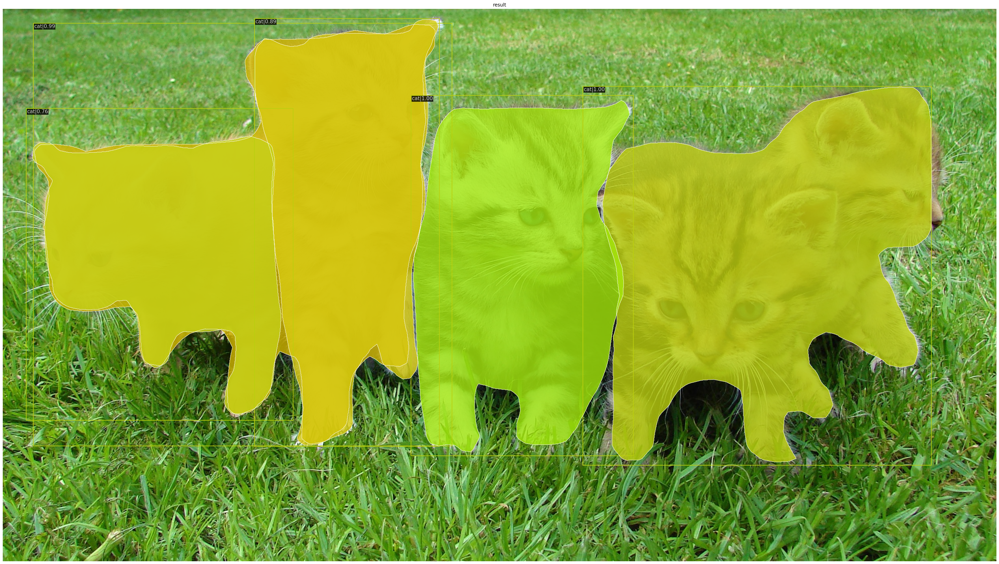

In [8]:
# Use the detector to do inference
img = DATA_DIR / "sample" / "kittens-cat-cat-puppy-rush-45170.jpg"
result = inference_detector(model, img)

# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.5)

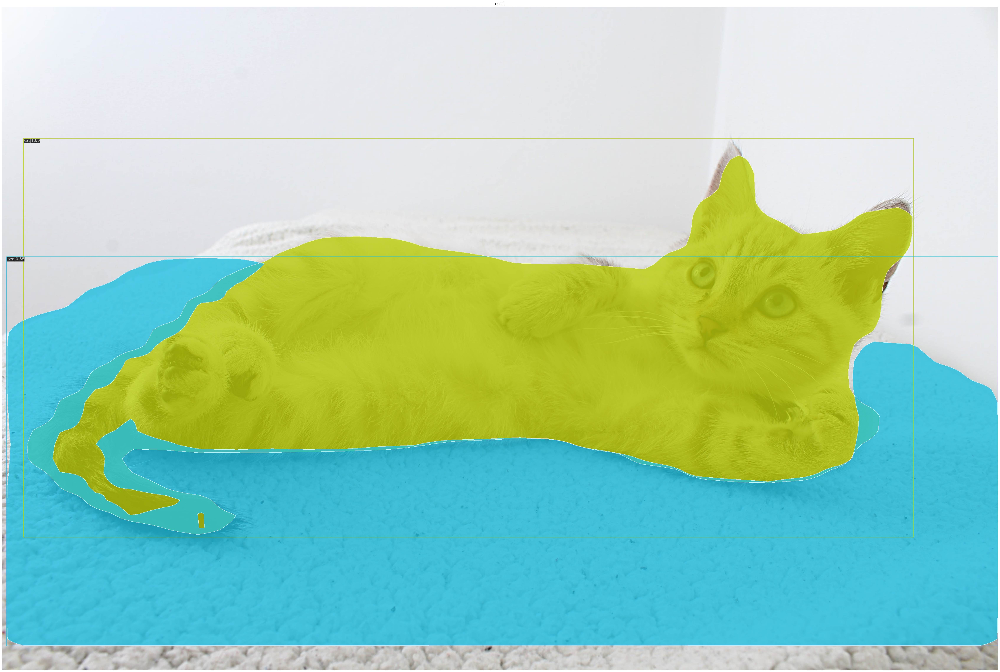

In [9]:
# Use the detector to do inference
img = DATA_DIR / "sample" / "pexels-photo-2558605.jpg"
result = inference_detector(model, img)

# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.5)